In [4]:
import pandas as pd
import datetime
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as stats
import pandas.plotting as pd_plot

import missingno as msno
import pandas_profiling

import re

import statsmodels

from sklearn.impute import KNNImputer
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn import svm
from sklearn import metrics
from sklearn.preprocessing  import StandardScaler 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge, RidgeCV
from sklearn.preprocessing import scale
from sklearn.linear_model import LassoCV
import random

In [36]:
def plot_corr(dataframe,size=10):                         # plots a graphical correlation matrix 
    corr = dataframe.corr()
    fig, ax = plt.subplots(figsize=(size, size))
    im = ax.matshow(corr,vmin = -1.0, vmax = 1.0)
    plt.xticks(range(len(corr.columns)), corr.columns);
    plt.xticks(rotation = 45)
    plt.yticks(range(len(corr.columns)), corr.columns);
    plt.colorbar(im, orientation = 'vertical')
    plt.title('Correlation Matrix')

In [13]:
DatabaseDF = pd.read_csv("CleanedDataset.csv")

In [14]:
#pandas_profiling.ProfileReport(DatabaseDF, title= "No Imputation Cleaned Dataset", correlations={"cramers": {"calculate": False}}).to_file("NoImputationReport.html")

In [15]:
DatabaseDF.isnull().sum()

Unnamed: 0                0
Operator                  0
Well Name                 0
Formation                 8
Lateral Length            8
Stages                  168
Township                  0
Range                     0
Section                   0
Total Prop, lbs           0
Fluid, bbls              17
Date Fracd                8
Best1 Mo BOPD          1550
Best3 Mo BOPD          1656
Best6 Mo BOPD          2043
Best9 Mo BOPD          2464
Best12 Mo BOPD         2973
Compl. Type             658
Latitude                  0
Longitude                 0
Fluid Type from DI     5776
SPACING_CAPPED            9
12 month Cum Prod         0
Completion Type         658
Sleeves                6300
P&P                    5676
Frac Ports            10839
Repeater Ports        10851
CT                    10841
Year Drilled              8
dtype: int64

In [16]:
header = "Percentage of Missing Data per Parameter"
print(header)
for column in DatabaseDF.columns:
    print()
    print(column + ":", format(DatabaseDF[str(column)].isnull().sum() * 100 / 10856, "0.4f"), "%")
    

Percentage of Missing Data per Parameter

Unnamed: 0: 0.0000 %

Operator: 0.0000 %

Well Name: 0.0000 %

Formation: 0.0737 %

Lateral Length: 0.0737 %

Stages: 1.5475 %

Township : 0.0000 %

Range: 0.0000 %

Section: 0.0000 %

Total Prop, lbs: 0.0000 %

Fluid, bbls: 0.1566 %

Date Fracd: 0.0737 %

Best1 Mo BOPD: 14.2778 %

Best3 Mo BOPD: 15.2542 %

Best6 Mo BOPD: 18.8191 %

Best9 Mo BOPD: 22.6971 %

Best12 Mo BOPD: 27.3858 %

Compl. Type: 6.0612 %

Latitude: 0.0000 %

Longitude: 0.0000 %

Fluid Type from DI: 53.2056 %

SPACING_CAPPED: 0.0829 %

12 month Cum Prod: 0.0000 %

Completion Type: 6.0612 %

Sleeves: 58.0324 %

P&P: 52.2845 %

Frac Ports: 99.8434 %

Repeater Ports: 99.9539 %

CT: 99.8618 %

Year Drilled: 0.0737 %


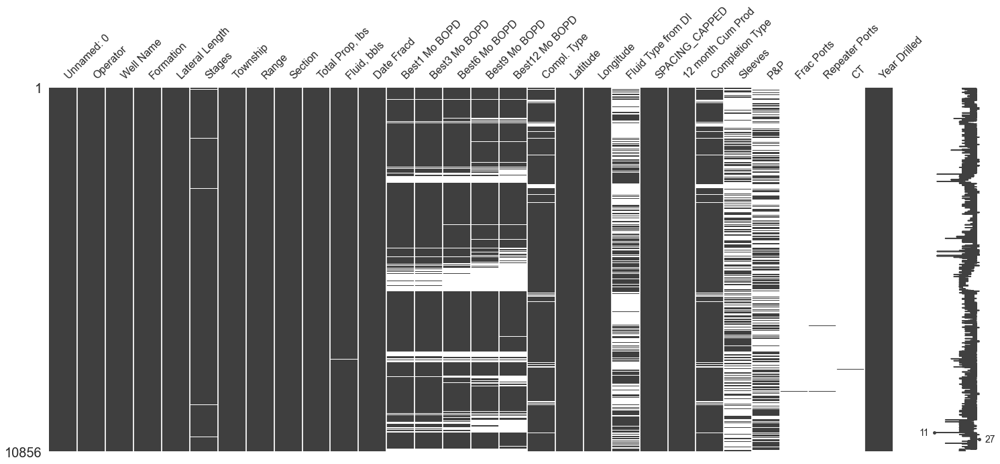

In [17]:
msno.matrix(DatabaseDF)

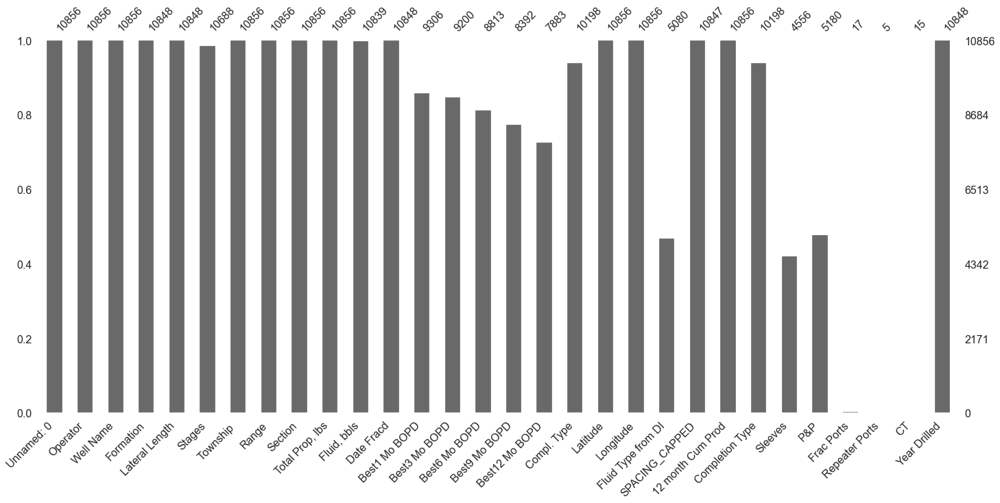

In [18]:
msno.bar(DatabaseDF)

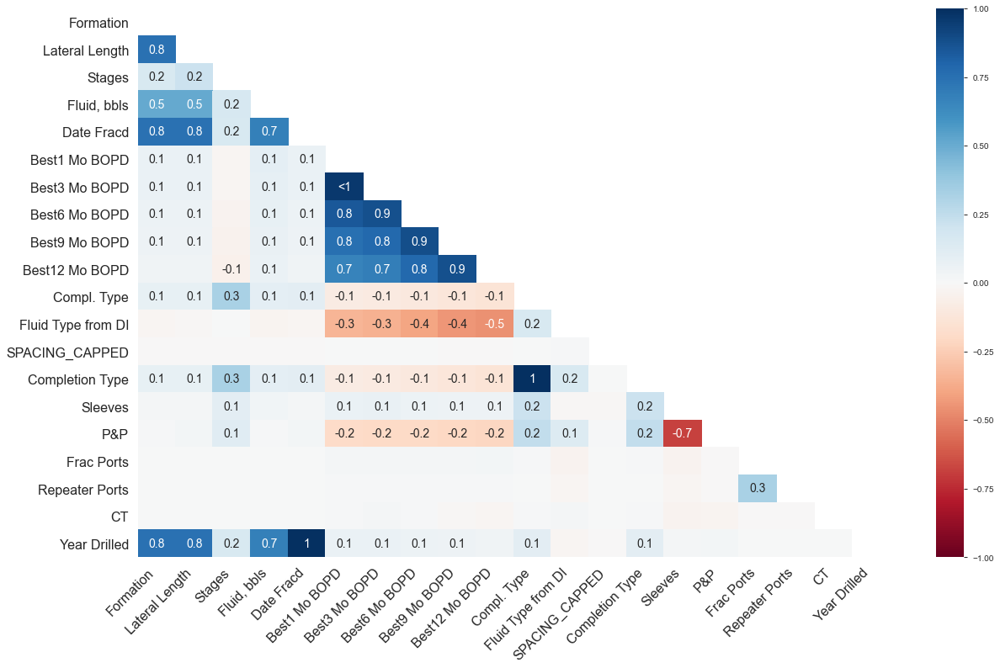

In [19]:
msno.heatmap(DatabaseDF)

### Nullity Heatmap analysis
This matrix maps pairwise relationships between two variables in terms of measuring how the presence of values for one variable predicts the presence of values for another with "1" meaning that the pressence of a value for variable guarantees the pressence of a value for another variable. "-1" means that the pressence of one variable guarantees the absence of a value for another. No numerical values implies that a variable is not good predictor of whether a value will appear in another variable.

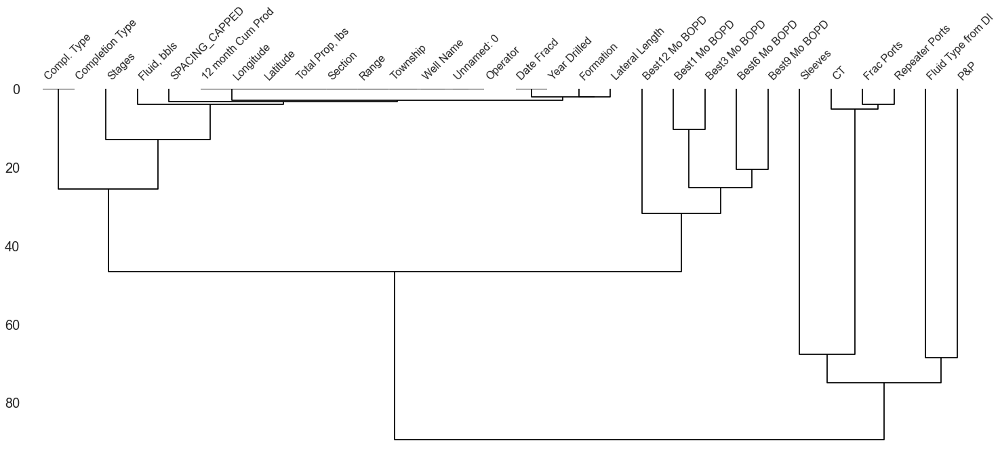

In [20]:
msno.dendrogram(DatabaseDF)

### Dendrogram Analysis
The dendrogram clusters the variables in terms of how well the "nullity" of one variable is used to predict the "nullity" of the others. The closer a cluster of variables is to zero, the closer their "nullity" correlates with each other. Certain Clusters' "nullity" do not strongly correlate with each other such as the "Best# Mo BOPD" Cluster with the other variables (not including the Completion Type Exclusive variables). Variables within larger clusters correlate slightly. This along with the "Nullity Correlation Heatmap" implies that the majority of variables are "Missing at Random (MAR)" Not completely random as within clusters of variables, certain variables will predict the nullity of information in others.

### Data Variables
<b>Operator:</b> Qualitative/Categorical (String)

<b>Well Name:</b> Qualitative (String)

<b>Formation:</b> Qualitative/Categorical (String)

<b>Lateral Length:</b> Quantitative

<b>Stages:</b> Quantitative (Integer)

<b>Township:</b> Quantitative (Float)

<b>Range:</b> Quantitative (Float)

<b>Section:</b> Quantitative (Integer)

<b>Total Prop:</b> Quantitative (Float)

<b>Fluid:</b> Quantitative (Float)

<b>Date Fracd:</b> Qualitative (Date "M/D/Y")

<b>Best1 Mo BOPD:</b> Quantitative (Float)

<b>Best3 Mo BOPD:</b> Quantitative (Float)

<b>Best6 Mo BOPD:</b> Quantitative (Float)

<b>Best9 Mo BOPD:</b> Quantitative (Float)

<b>Best12 Mo BOPD:</b> Quantitative (Float)

<b>Compl. Type:</b> Qualitative/Categorical (String)

<b>Latitude:</b> Quantitative (Float)

<b>Longitude:</b> Quantitative (Float)

<b>Fluid Type from DI:</b> Qualitative/Categorical (String)

<b>SPACING_CAPPED:</b> Quantitative (Float)

<b>12 month Cum Prod:</b> Quantitative (Float)

<b>Completion Type:</b> Qualitative/Categorical (String) 
    <i>*Use instead of Compl. Type</i>

<b>Sleeves:</b> Quantitative (Integer)
    <i>*Only when Completion Type indicates Sleeve</i>

<b>P and P:</b> Quantitative (Integer)
    <i>*Only when Completion Type indicates P and P</i>

<b>Frac Ports:</b> Quantitative (Integer)
    <i>*Only When Completion Type indicates Frac Ports</i>
    

<b>Repeater Ports:</b> Quantitative (Integer)
    <i>*Only When Completion Type indicates Repeater Ports</i>
    
<b>CT:</b> Quantitative (Integer)
    <i>*Only when Completion Type indicates CT</i> 

<b>Year Drilled:</b> Quantitative (Integer)


# Aggressive Methods: Dropping Data

## Dropping rows which include missing Data
This is where the first way to deal with missing values, that is to simply remove the bothersome data. This method is simple enough, if an entry has some missing data, the entry is dropped. This is only valid when either the percentage of data missing is low (<5%), the data is MCAR. Shortcomings of this method include the loss of information from the other variables.

In [97]:
DatabaseDFDrop = DatabaseDF.copy().drop(["Unnamed: 0", "Sleeves", "P&P", "Frac Ports", \
                                      "Repeater Ports", "CT"], axis = 1)
#  Dropping these collumns as they either only refer to the order a well entry occurs in the
#  dataset or they are missing >50% of the data and only apply to certain types of wells(More for
#  clustering)
DatabaseDFDrop = DatabaseDFDrop.dropna()

#### Descriptive Data comparison

In [120]:
DataframeOriginal = DatabaseDF.copy().drop(["Unnamed: 0", "Sleeves", "P&P", "Frac Ports", \
                                      "Repeater Ports", "CT"], axis = 1)
print("Original Dataset Descriptive Statistics")
DataframeOriginal.describe().transpose()

Original Dataset Descriptive Statistics


,count,mean,std,min,25%,50%,75%,max
Lateral Length,10848.0,8.914655e+03,1.833824e+03,3.000000,8.916000e+03,9.427000e+03,9.799000e+03,2.223100e+04
Stages,10688.0,2.799775e+01,1.098972e+01,1.000000,2.200000e+01,3.000000e+01,3.400000e+01,9.400000e+01
Township,10856.0,1.521737e+02,4.829458e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,10856.0,9.591489e+01,3.479933e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,10856.0,1.819805e+01,1.044430e+01,1.000000,9.000000e+00,1.800000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",10856.0,3.332069e+06,2.364422e+06,0.000000,1.999804e+06,2.958260e+06,3.879750e+06,2.874457e+07
"Fluid, bbls",10839.0,6.922238e+04,5.806813e+04,0.000000,3.477800e+04,5.512700e+04,8.006400e+04,5.985620e+05
Best1 Mo BOPD,9306.0,4.919044e+02,2.737637e+02,1.873767,2.911571e+02,4.540434e+02,6.408284e+02,2.264727e+03
Best3 Mo BOPD,9200.0,3.946934e+02,2.171532e+02,1.873767,2.382424e+02,3.623548e+02,5.066185e+02,1.819044e+03
Best6 Mo BOPD,8813.0,3.213256e+02,1.770620e+02,8.355249,1.984111e+02,2.929158e+02,4.076540e+02,1.635180e+03


In [122]:
print("Descriptive Statistics after dropping missing data")
DatabaseDFDrop.describe().transpose()

Descriptive Statistics after dropping missing data


,count,mean,std,min,25%,50%,75%,max
Lateral Length,2471.0,9.120968e+03,1.461903e+03,1216.000000,9.051500e+03,9.451000e+03,9.802000e+03,1.481100e+04
Stages,2471.0,2.937515e+01,7.341282e+00,1.000000,2.600000e+01,3.000000e+01,3.200000e+01,8.400000e+01
Township,2471.0,1.518219e+02,5.204625e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,2471.0,9.625293e+01,3.521071e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,2471.0,1.790732e+01,1.053407e+01,1.000000,9.000000e+00,1.700000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",2471.0,3.182872e+06,1.847780e+06,0.000000,2.246711e+06,2.967800e+06,3.670748e+06,2.759017e+07
"Fluid, bbls",2471.0,6.401743e+04,4.368331e+04,0.000000,3.966800e+04,5.530100e+04,7.428350e+04,4.604490e+05
Best1 Mo BOPD,2471.0,5.126569e+02,2.684534e+02,27.613412,3.170776e+02,4.785667e+02,6.524490e+02,1.967850e+03
Best3 Mo BOPD,2471.0,4.106984e+02,2.139971e+02,23.361823,2.624644e+02,3.789393e+02,5.182117e+02,1.819044e+03
Best6 Mo BOPD,2471.0,3.339274e+02,1.752727e+02,21.668858,2.167625e+02,3.047995e+02,4.141300e+02,1.534385e+03


##### Analysis
Todo

### Regression Models
Utilizing the quantitative variables to evaluate methods to handle missing data

#### Lasso Regression
Todo

Train score: 0.9786378631599746
Test score: 0.9760762968090706
Number of coefficients used: 9
Root mean squared error: 7.710497207988396
[-2.57784963e-04  1.02452720e-01  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00  5.96036875e-07  7.44729508e-06  0.00000000e+00
  0.00000000e+00  0.00000000e+00  8.93327478e-02  2.59843048e-01
  1.21535440e-01  0.00000000e+00 -3.46797177e-04  8.00760800e-01]


Lateral Length    -2.577850e-04
Stages             1.024527e-01
Township           0.000000e+00
Range             -0.000000e+00
Section           -0.000000e+00
Total Prop, lbs    5.960369e-07
Fluid, bbls        7.447295e-06
Best1 Mo BOPD      0.000000e+00
Best3 Mo BOPD      0.000000e+00
Best6 Mo BOPD      0.000000e+00
Best9 Mo BOPD      8.933275e-02
Best12 Mo BOPD     2.598430e-01
Latitude           1.215354e-01
Longitude          0.000000e+00
SPACING_CAPPED    -3.467972e-04
Year Drilled       8.007608e-01
dtype: float64

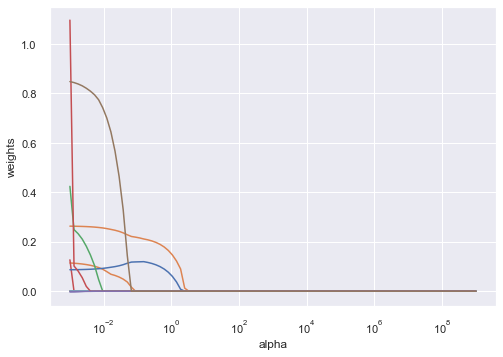

In [108]:
from math import sqrt
X = DatabaseDFDrop.copy().select_dtypes([np.number]).drop("12 month Cum Prod", axis = 1)
scaler = StandardScaler()
sX = scaler.fit_transform(X)
#DataframeT = DataframeT.select_dtypes([np.number])
y = DatabaseDFDrop["12 month Cum Prod"]
sy = scaler.fit_transform(y.values.reshape((-1,1)))
alphas = 10**np.linspace(10,-2, 100)*0.05
coefs = []
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .4, random_state = 1)
Lasso = linear_model.Lasso(max_iter = 300000, tol = 0.0001, normalize = True)
for a in alphas:
    Lasso.set_params(alpha = a)
    Lasso.fit(X_train, y_train)
    coefs.append(Lasso.coef_)
ax = plt.gca()
ax.plot(alphas*2, coefs)
ax.set_xscale("log")
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
    
Lassocv = LassoCV(alphas = None, cv = 20, max_iter = 300000, normalize = True)
Lassocv.fit(X_train, y_train)

Lasso.set_params(alpha = Lassocv.alpha_)
Lasso.fit(X_train, y_train)

y_pred = Lasso.predict(X_test)
rmse = sqrt(metrics.mean_squared_error(y_test, y_pred))

print("Train score:", Lasso.score(X_train, y_train))
print("Test score:", Lasso.score(X_test, y_test))
print("Number of coefficients used:", np.sum(Lasso.coef_!=0))
print("Root mean squared error:", rmse)
print(Lasso.coef_)
pd.Series(Lasso.coef_, index = X.columns)

#### Ridge Regression
Todo

Lateral Length    -2.954102e-04
Stages             9.500289e-02
Township          -5.471235e-01
Range              1.144471e+00
Section            1.705671e-02
Total Prop, lbs    5.922683e-07
Fluid, bbls        7.447129e-06
Best1 Mo BOPD     -1.258467e-03
Best3 Mo BOPD      2.442943e-04
Best6 Mo BOPD     -1.222913e-03
Best9 Mo BOPD      1.040855e-01
Best12 Mo BOPD     2.477599e-01
Latitude           8.003278e+00
Longitude          9.033247e+00
SPACING_CAPPED    -5.958902e-04
Year Drilled       8.363837e-01
dtype: float64
Train score: 0.9794853760772271
Test score: 0.9736697457255207
Root Mean squared error: 8.15147353207169
Mean Absolute Error: 4.276768127078991
Mean Squared Error: 66.44652074406531


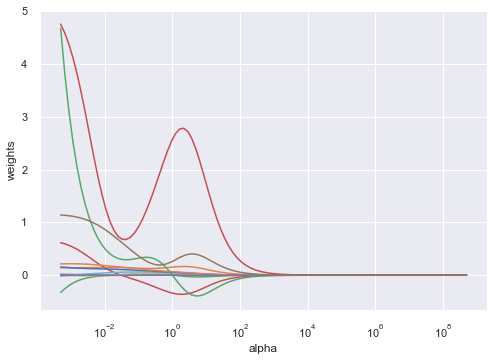

In [115]:
X1 = DatabaseDFDrop.copy().select_dtypes([np.number]).drop("12 month Cum Prod", axis = 1) 

y1 = DatabaseDFDrop["12 month Cum Prod"]
alphas = 10**np.linspace(10, -2, 100)*.05
coefs = []
ridge = Ridge(normalize = True)
for a in alphas:
    ridge.set_params(alpha = a)
    ridge.fit(X1, y1)
    coefs.append(ridge.coef_)
np.shape(coefs)
ax = plt.gca()
ax.plot(alphas, coefs)
ax.set_xscale('log')
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size = 0.3, random_state = 1)
ridgecv = RidgeCV(alphas = alphas, scoring = 'neg_mean_squared_error', normalize = True)
ridgecv.fit(X1_train, y1_train)
ridgecv.alpha_
ridge = Ridge(alpha = ridgecv.alpha_, normalize = True)
ridge.fit(X1_train, y1_train)
y1_pred = ridge.predict(X1_test)
print(pd.Series(ridge.coef_, index = X1.columns))
print("Train score:", ridge.score(X1_train, y1_train))
print("Test score:", ridge.score(X1_test, y1_test))
print("Root Mean squared error:", sqrt(metrics.mean_squared_error(y1_test, y1_pred)))
print("Mean Absolute Error:", metrics.mean_absolute_error(y1_test, y1_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y1_test, y1_pred))

### Dimension Reduction/Clustering
Exploratory 
Todo

## Correlations and Variable Interactions

Original Dataset


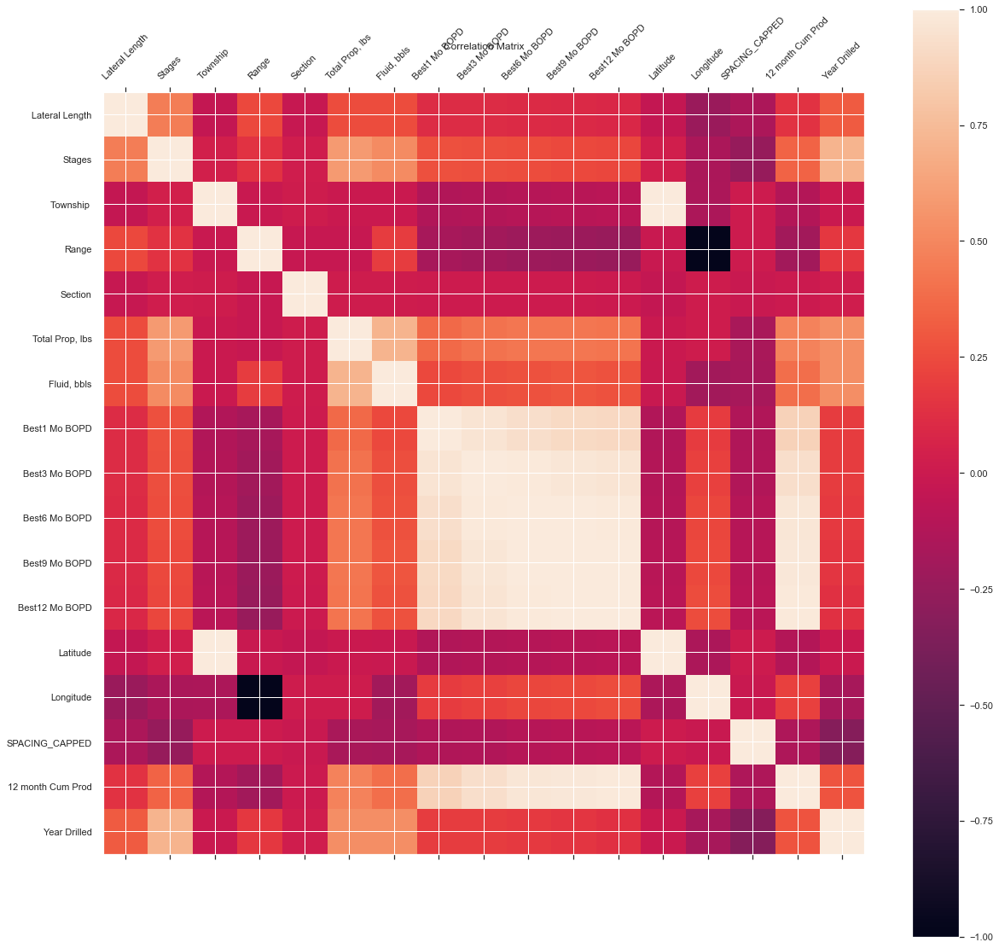

In [135]:
print("Original Dataset")
plot_corr(DataframeOriginal, 20)
plt.show()

Dataset with Removed 'NAN' values


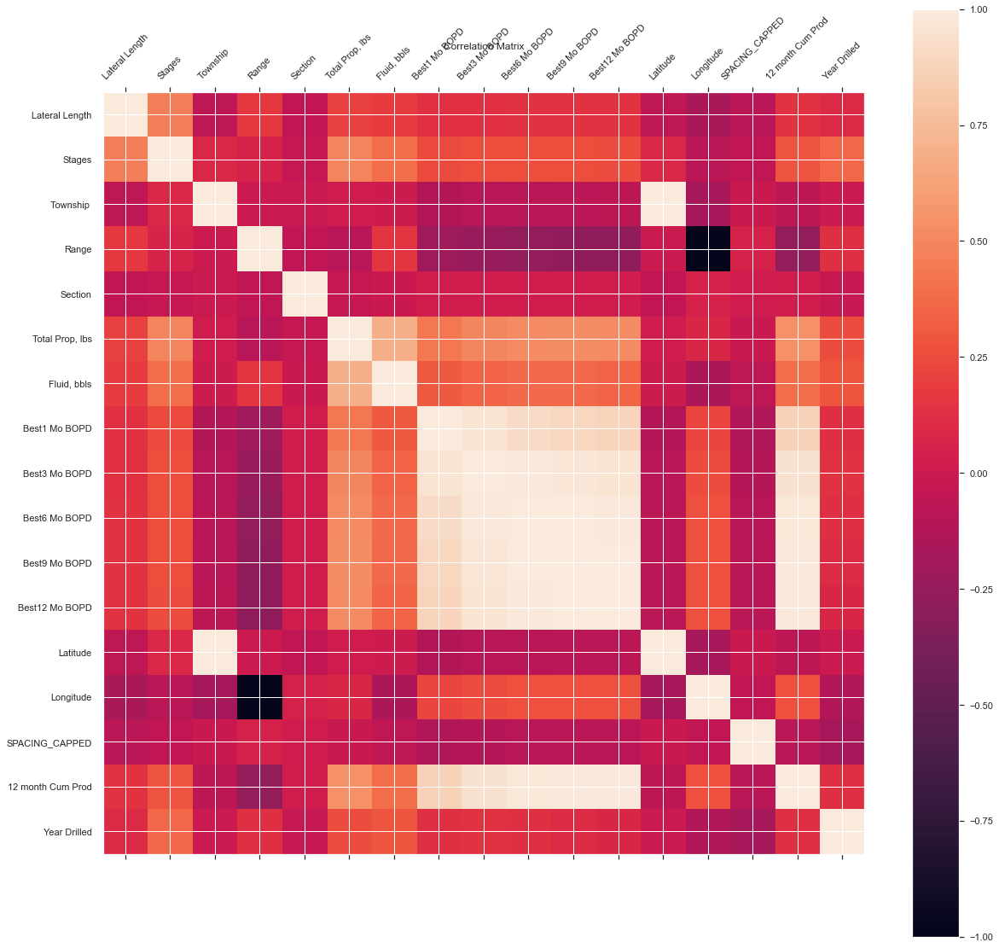

In [136]:
print("Dataset with Removed 'NAN' values")
plot_corr(DatabaseDFDrop, 20)
plt.show()

Original Dataset


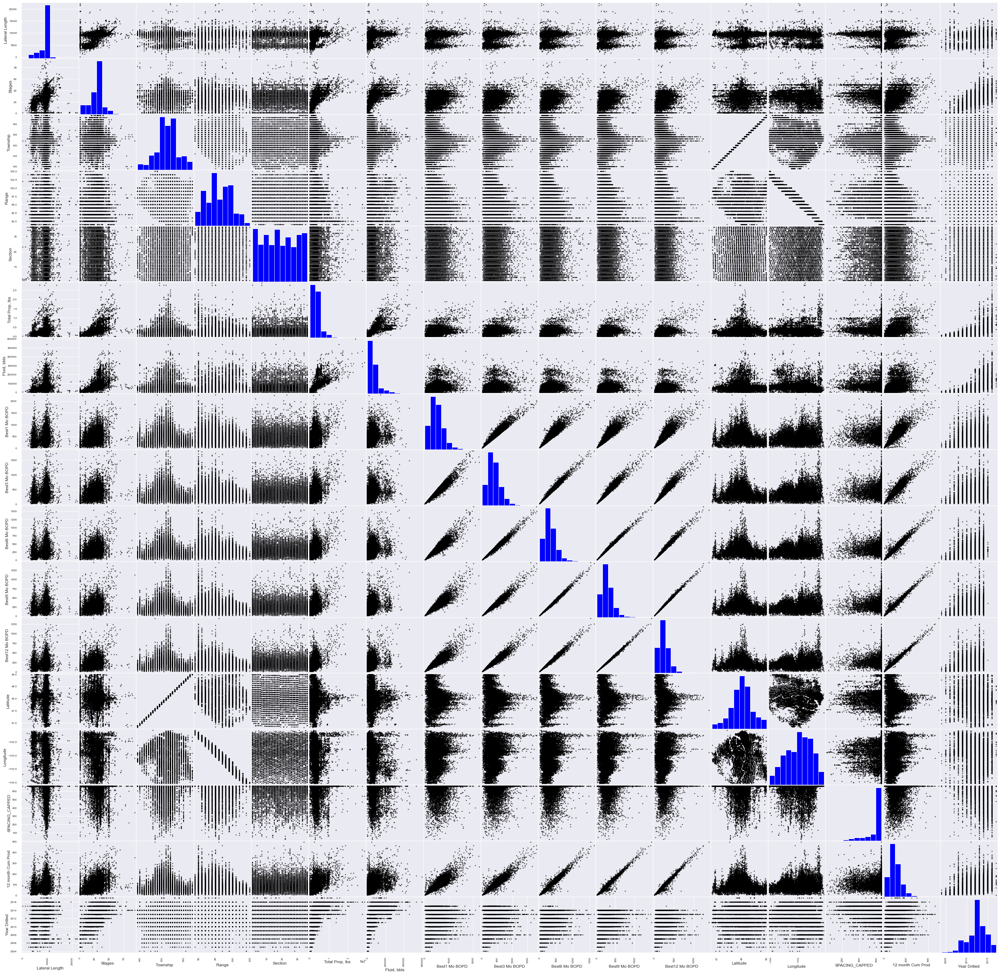

In [139]:
print("Original Dataset")
pd_plot.scatter_matrix(DataframeOriginal, alpha = 0.7,
                       figsize=(50,50),color='black',hist_kwds={'color':['blue']})
plt.show()

Dataset with Removed 'NAN' Values


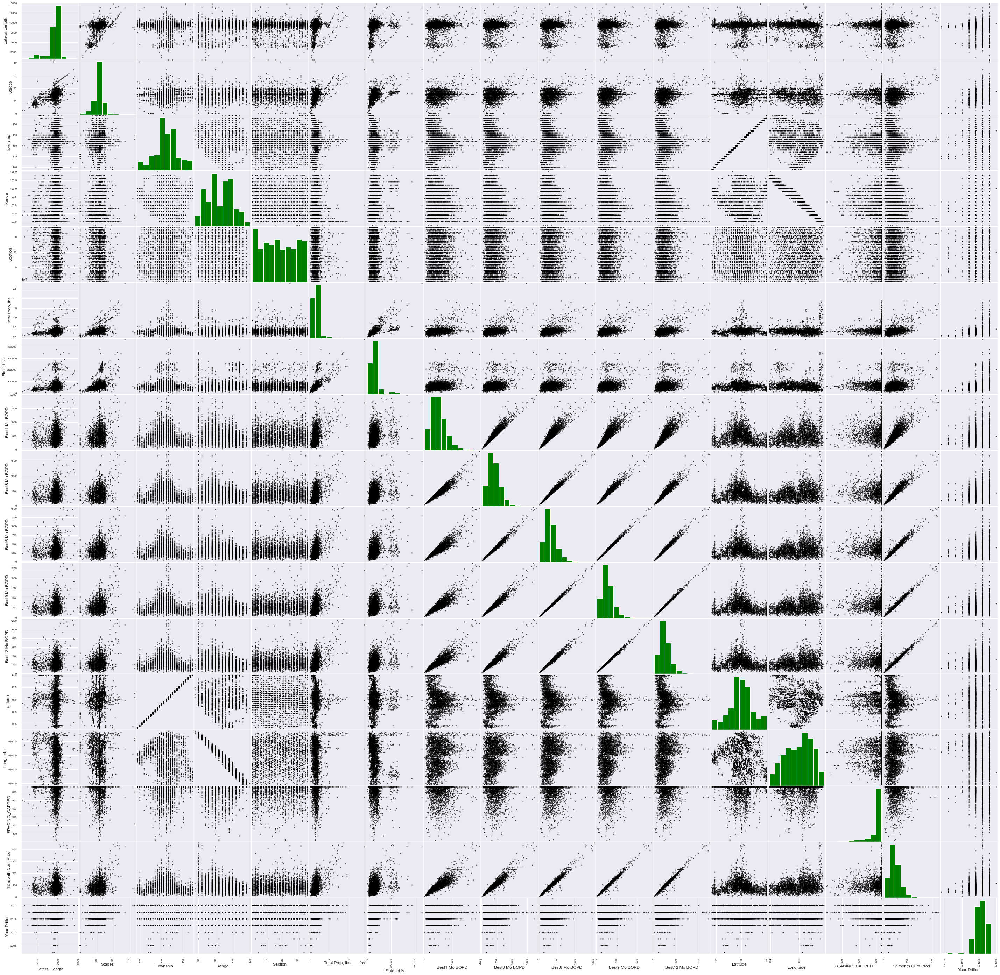

In [137]:
print("Dataset with Removed 'NAN' Values")
pd_plot.scatter_matrix(DatabaseDFDrop, alpha = 0.7,              # pandas matrix scatter plot
    figsize=(50, 50),color = 'black', hist_kwds={'color':['green']})
plt.show()

# Imputation Attempts and Analysis

## Single Imputation: Mean Imputation
Lowers variability and covariance


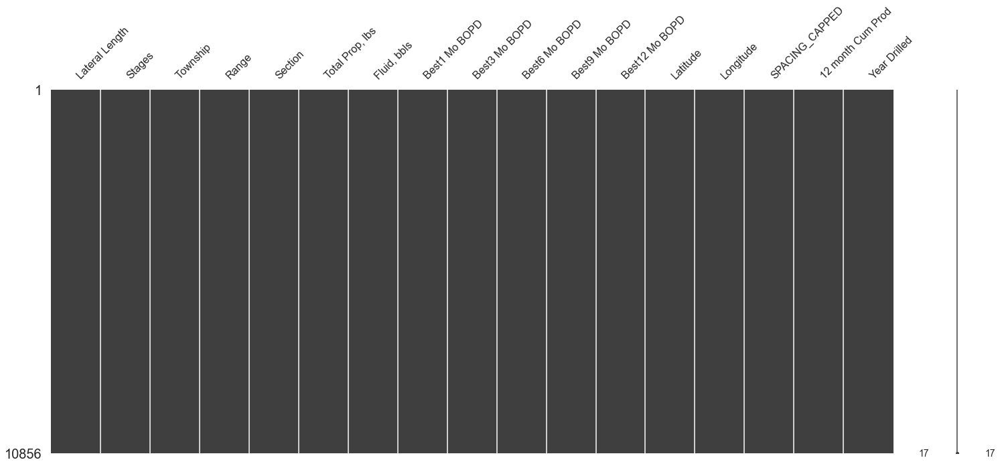

In [125]:
# Applying the mean (or nearest integer to the mean) for the quantitative variables where it applies

DatabaseDFMean = DatabaseDF.copy().drop(["Unnamed: 0", "Sleeves", "P&P", "Frac Ports", \
                                      "Repeater Ports", "CT"], axis = 1)
DatabaseDFMean["Stages"] = DatabaseDFMean["Stages"].replace(np.nan, round(DatabaseDF["Stages"].mean()))
DatabaseDFMean["Fluid, bbls"] = DatabaseDFMean["Fluid, bbls"].replace(np.nan, round(DatabaseDF["Fluid, bbls"].mean()))
DatabaseDFMean["Best1 Mo BOPD"] = DatabaseDFMean["Best1 Mo BOPD"].replace(np.nan, DatabaseDF["Best1 Mo BOPD"].mean())
DatabaseDFMean["Best3 Mo BOPD"] = DatabaseDFMean["Best3 Mo BOPD"].replace(np.nan, DatabaseDF["Best3 Mo BOPD"].mean())
DatabaseDFMean["Best6 Mo BOPD"] = DatabaseDFMean["Best6 Mo BOPD"].replace(np.nan, DatabaseDF["Best6 Mo BOPD"].mean())
DatabaseDFMean["Best9 Mo BOPD"] = DatabaseDFMean["Best9 Mo BOPD"].replace(np.nan, DatabaseDF["Best9 Mo BOPD"].mean())
DatabaseDFMean["Best12 Mo BOPD"] = DatabaseDFMean["Best12 Mo BOPD"].replace(np.nan, DatabaseDF["Best12 Mo BOPD"].mean())
DatabaseDFMean["Lateral Length"] = DatabaseDFMean["Lateral Length"].replace(np.nan, DatabaseDF["Lateral Length"].mean())
DatabaseDFMean["SPACING_CAPPED"] = DatabaseDFMean["SPACING_CAPPED"].replace(np.nan, DatabaseDF["SPACING_CAPPED"].mean())
DatabaseDFMean["Year Drilled"] = DatabaseDFMean["Year Drilled"].replace(np.nan, round(DatabaseDF["Year Drilled"].mean()))
DatabaseDFMean = DatabaseDFMean.select_dtypes([np.number])

msno.matrix(DatabaseDFMean)

#### Descriptive Data Comparision

In [127]:
print("Original Dataset Descriptive Statistics")
DataframeOriginal.describe().transpose()

Original Dataset Descriptive Statistics


,count,mean,std,min,25%,50%,75%,max
Lateral Length,10848.0,8.914655e+03,1.833824e+03,3.000000,8.916000e+03,9.427000e+03,9.799000e+03,2.223100e+04
Stages,10688.0,2.799775e+01,1.098972e+01,1.000000,2.200000e+01,3.000000e+01,3.400000e+01,9.400000e+01
Township,10856.0,1.521737e+02,4.829458e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,10856.0,9.591489e+01,3.479933e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,10856.0,1.819805e+01,1.044430e+01,1.000000,9.000000e+00,1.800000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",10856.0,3.332069e+06,2.364422e+06,0.000000,1.999804e+06,2.958260e+06,3.879750e+06,2.874457e+07
"Fluid, bbls",10839.0,6.922238e+04,5.806813e+04,0.000000,3.477800e+04,5.512700e+04,8.006400e+04,5.985620e+05
Best1 Mo BOPD,9306.0,4.919044e+02,2.737637e+02,1.873767,2.911571e+02,4.540434e+02,6.408284e+02,2.264727e+03
Best3 Mo BOPD,9200.0,3.946934e+02,2.171532e+02,1.873767,2.382424e+02,3.623548e+02,5.066185e+02,1.819044e+03
Best6 Mo BOPD,8813.0,3.213256e+02,1.770620e+02,8.355249,1.984111e+02,2.929158e+02,4.076540e+02,1.635180e+03


In [128]:
print("Mean Imputation Dataset Descriptive Statistics")
DatabaseDFMean.describe().transpose()

Mean Imputation Dataset Descriptive Statistics


,count,mean,std,min,25%,50%,75%,max
Lateral Length,10856.0,8.914655e+03,1.833148e+03,3.000000,8.914655e+03,9.427000e+03,9.799000e+03,2.223100e+04
Stages,10856.0,2.799779e+01,1.090435e+01,1.000000,2.300000e+01,3.000000e+01,3.400000e+01,9.400000e+01
Township,10856.0,1.521737e+02,4.829458e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,10856.0,9.591489e+01,3.479933e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,10856.0,1.819805e+01,1.044430e+01,1.000000,9.000000e+00,1.800000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",10856.0,3.332069e+06,2.364422e+06,0.000000,1.999804e+06,2.958260e+06,3.879750e+06,2.874457e+07
"Fluid, bbls",10856.0,6.922238e+04,5.802264e+04,0.000000,3.481525e+04,5.518281e+04,8.002900e+04,5.985620e+05
Best1 Mo BOPD,10856.0,4.919044e+02,2.534657e+02,1.873767,3.173817e+02,4.919044e+02,6.052268e+02,2.264727e+03
Best3 Mo BOPD,10856.0,3.946934e+02,1.999041e+02,1.873767,2.607002e+02,3.946934e+02,4.771176e+02,1.819044e+03
Best6 Mo BOPD,10856.0,3.213256e+02,1.595320e+02,8.355249,2.201677e+02,3.213256e+02,3.765957e+02,1.635180e+03


##### Analysis
Todo

### Regression Models
Utilizing the quantitative variables to evaluate methods to handle missing data

#### Lasso Regression
Todo

Train score: 0.7684642578977617
Test score: 0.77350059098711
Number of coefficients used: 12
Root mean squared error: 25.37035568900135
[-0.00000000e+00  1.32252731e-01 -3.78331470e-01 -0.00000000e+00
 -2.26025261e-02  3.33877563e-06  1.16466090e-04  0.00000000e+00
  5.46861671e-02  8.69016991e-02  3.48904238e-02  9.56251248e-02
 -0.00000000e+00  9.28425050e+00 -8.34199308e-03  6.13930509e-01]


Lateral Length    -0.000000
Stages             0.132253
Township          -0.378331
Range             -0.000000
Section           -0.022603
Total Prop, lbs    0.000003
Fluid, bbls        0.000116
Best1 Mo BOPD      0.000000
Best3 Mo BOPD      0.054686
Best6 Mo BOPD      0.086902
Best9 Mo BOPD      0.034890
Best12 Mo BOPD     0.095625
Latitude          -0.000000
Longitude          9.284250
SPACING_CAPPED    -0.008342
Year Drilled       0.613931
dtype: float64

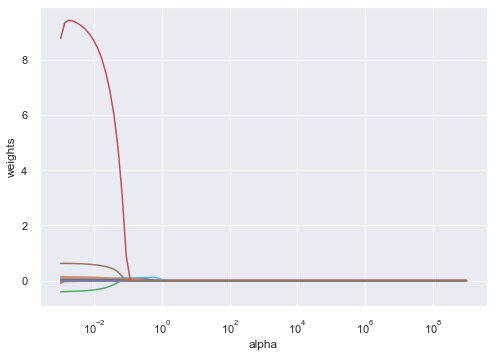

In [130]:
X2 = DatabaseDFMean.copy().drop("12 month Cum Prod", axis = 1)
scaler = StandardScaler()
sX2 = scaler.fit_transform(X2)
#DataframeT = DataframeT.select_dtypes([np.number])
y2 = DatabaseDFMean["12 month Cum Prod"]
sy2 = scaler.fit_transform(y2.values.reshape((-1,1)))
alphas = 10**np.linspace(10,-2, 100)*0.05
coefs = []
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size = .4, random_state = 1)
Lasso = linear_model.Lasso(max_iter = 300000, tol = 0.0001, normalize = True)
for a in alphas:
    Lasso.set_params(alpha = a)
    Lasso.fit(X2_train, y2_train)
    coefs.append(Lasso.coef_)
ax = plt.gca()
ax.plot(alphas*2, coefs)
ax.set_xscale("log")
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
    
Lassocv = LassoCV(alphas = None, cv = 20, max_iter = 300000, normalize = True)
Lassocv.fit(X2_train, y2_train)

Lasso.set_params(alpha = Lassocv.alpha_)
Lasso.fit(X2_train, y2_train)

y2_pred = Lasso.predict(X2_test)
rmse = sqrt(metrics.mean_squared_error(y2_test, y2_pred))

print("Train score:", Lasso.score(X2_train, y2_train))
print("Test score:", Lasso.score(X2_test, y2_test))
print("Number of coefficients used:", np.sum(Lasso.coef_!=0))
print("Root mean squared error:", rmse)
print(Lasso.coef_)
pd.Series(Lasso.coef_, index = X2.columns)

#### Ridge Regression
Todo

Lateral Length    -0.000117
Stages             0.139270
Township          -0.325959
Range             -0.396250
Section           -0.038388
Total Prop, lbs    0.000003
Fluid, bbls        0.000121
Best1 Mo BOPD     -0.003466
Best3 Mo BOPD      0.064136
Best6 Mo BOPD      0.070310
Best9 Mo BOPD      0.051850
Best12 Mo BOPD     0.089488
Latitude          -1.278290
Longitude          6.335799
SPACING_CAPPED    -0.009455
Year Drilled       0.685188
dtype: float64
Train score: 0.7700713311089016
Test score: 0.7715206303404607
Root Mean squared error: 25.54038495899107
Mean Absolute Error: 15.547677261191017
Mean Squared Error: 652.3112638534573


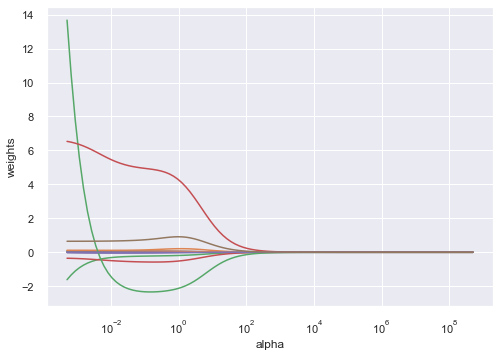

In [132]:
X3 = DatabaseDFMean.copy().drop("12 month Cum Prod", axis = 1) 

y3 = DatabaseDFMean["12 month Cum Prod"]
alphas = 10**np.linspace(10, -2, 100)*.05
coefs = []
ridge = Ridge(normalize = True)
for a in alphas:
    ridge.set_params(alpha = a)
    ridge.fit(X3, y3)
    coefs.append(ridge.coef_)
np.shape(coefs)
ax = plt.gca()
ax.plot(alphas, coefs)
ax.set_xscale('log')
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size = 0.3, random_state = 1)
ridgecv = RidgeCV(alphas = alphas, scoring = 'neg_mean_squared_error', normalize = True)
ridgecv.fit(X3_train, y3_train)
ridgecv.alpha_
ridge = Ridge(alpha = ridgecv.alpha_, normalize = True)
ridge.fit(X3_train, y3_train)
y3_pred = ridge.predict(X3_test)
print(pd.Series(ridge.coef_, index = X3.columns))
print("Train score:", ridge.score(X3_train, y3_train))
print("Test score:", ridge.score(X3_test, y3_test))
print("Root Mean squared error:", sqrt(metrics.mean_squared_error(y3_test, y3_pred)))
print("Mean Absolute Error:", metrics.mean_absolute_error(y3_test, y3_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y3_test, y3_pred))


### Dimension Reduction/Clustering
Exploratory
Todo

## Correlations and Variable interactions


Original Dataset


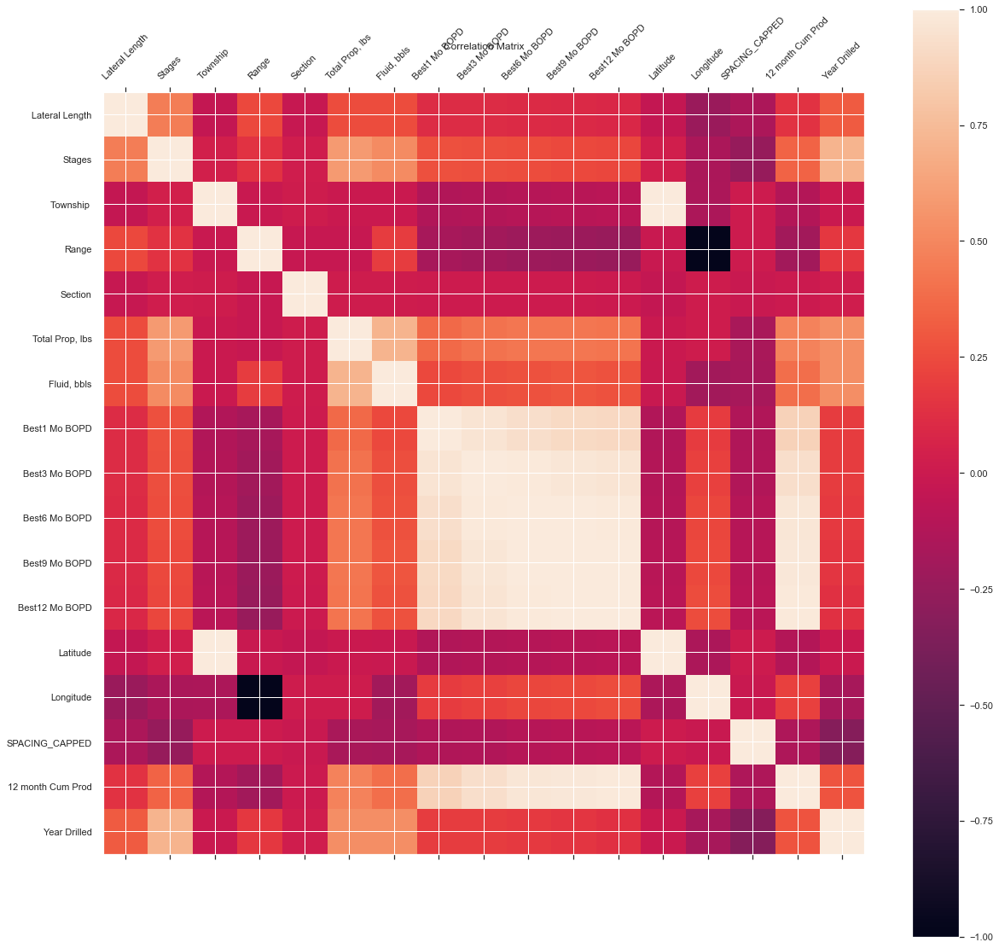

In [140]:
print("Original Dataset")
plot_corr(DataframeOriginal, 20)
plt.show()

Dataset with Mean Imputation


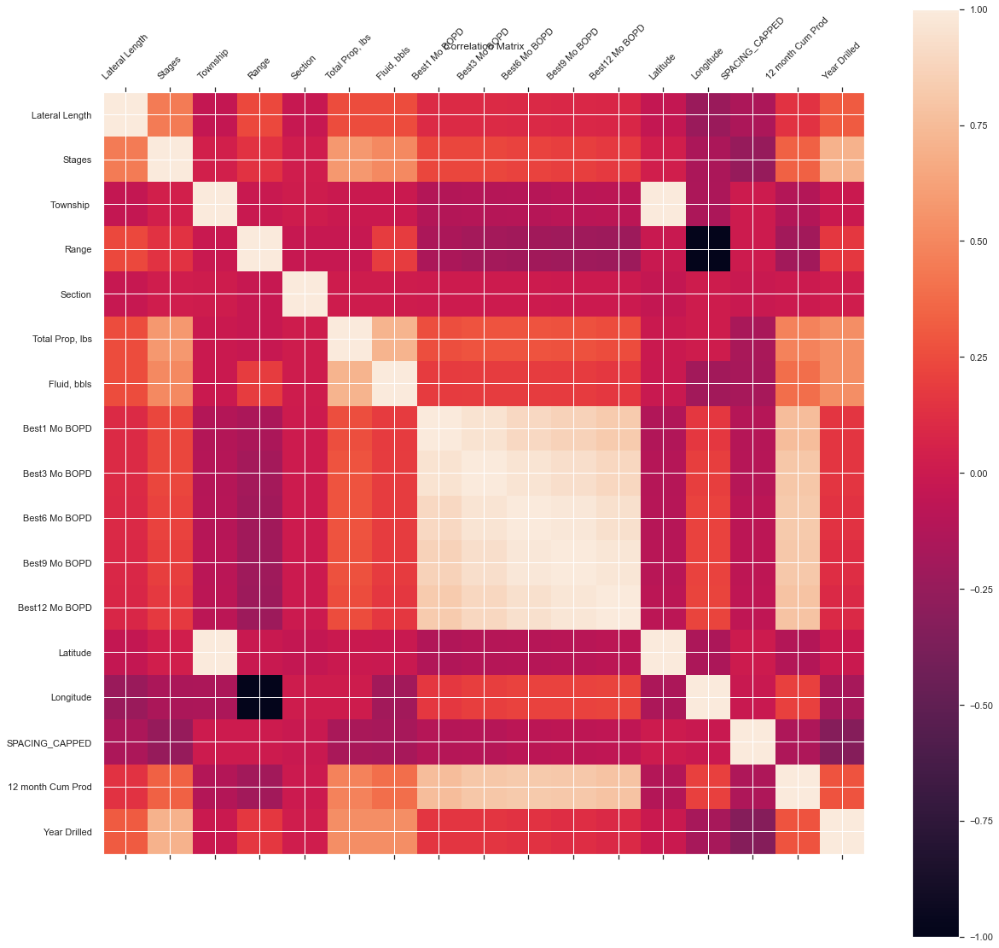

In [141]:
print("Dataset with Mean Imputation")
plot_corr(DatabaseDFMean, 20)
plt.show()

Original Dataset


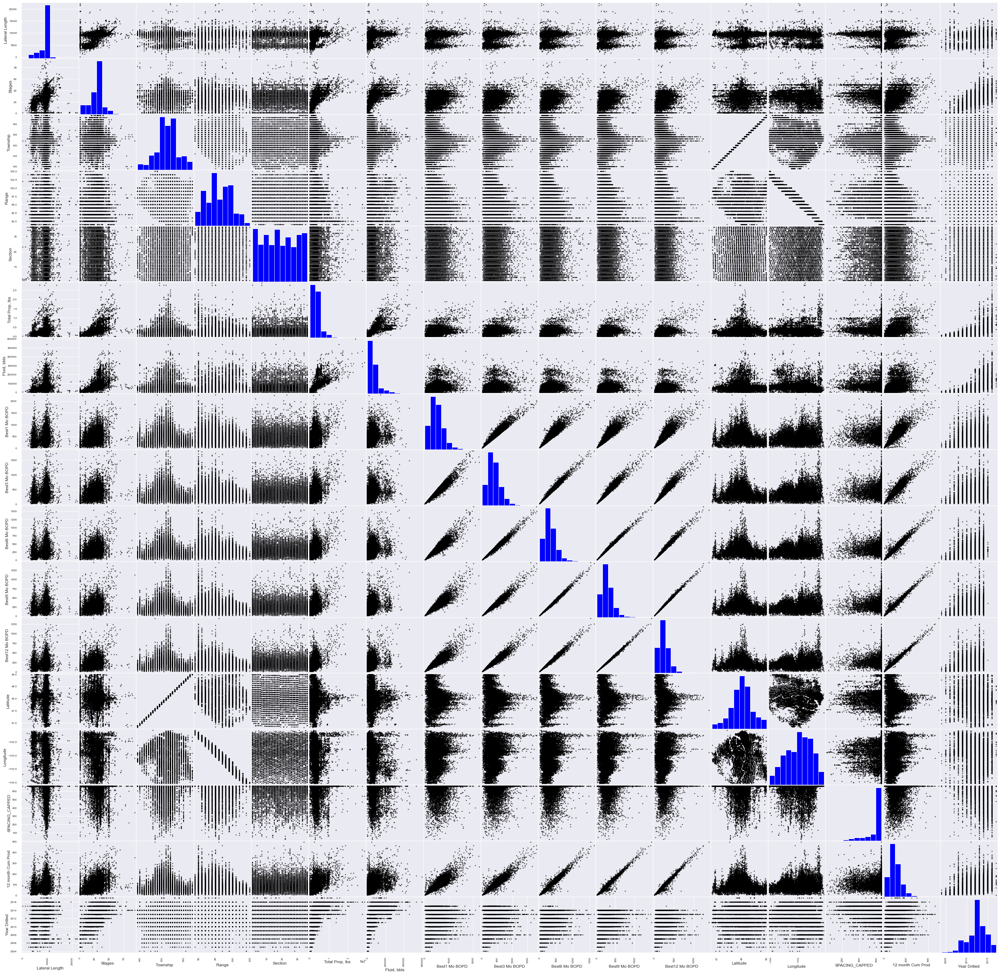

In [142]:
print("Original Dataset")
pd_plot.scatter_matrix(DataframeOriginal, alpha = 0.7,
                       figsize=(50,50),color='black',hist_kwds={'color':['blue']})
plt.show()

Dataset with Mean Imputation


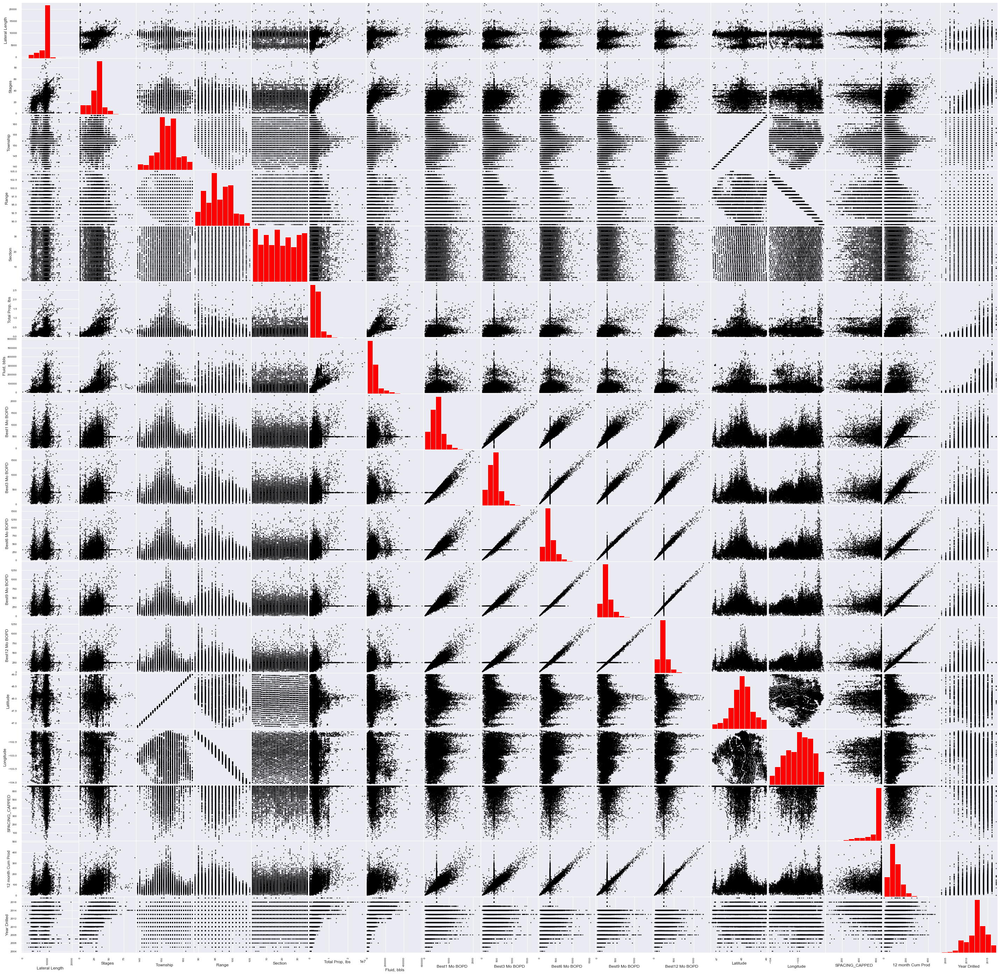

In [145]:
print("Dataset with Mean Imputation")
pd_plot.scatter_matrix(DatabaseDFMean, alpha = 0.7,
          figsize=(50,50),color='black',hist_kwds={'color':['red']})
plt.show()

## Sklearn Multivariate Feature Imputation: Iterative Imputer
Todo

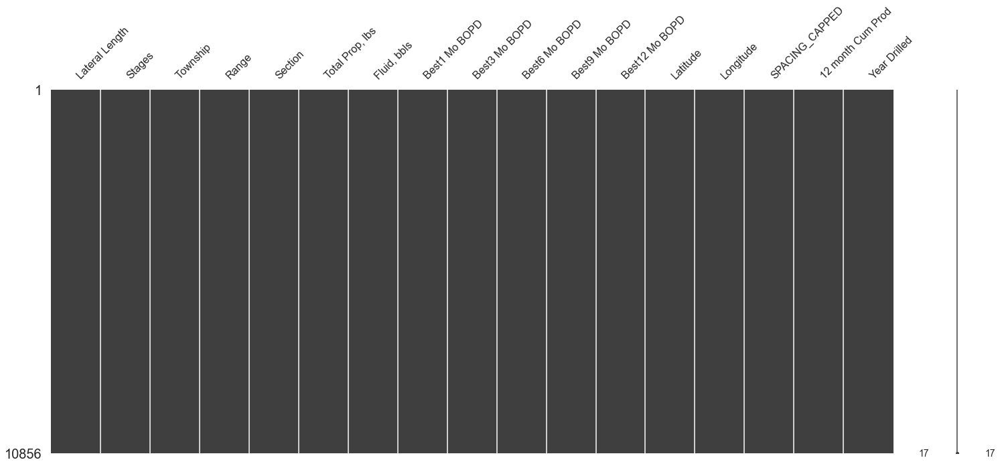

In [157]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
imp = IterativeImputer(max_iter=10, random_state=0)
imp.fit(DataframeOriginal.copy().select_dtypes([np.number]))
DatabaseDFII = pd.DataFrame(imp.transform(DataframeOriginal.copy().select_dtypes([np.number])),\
                            columns = DataframeOriginal.copy().select_dtypes([np.number]).columns)
msno.matrix(DatabaseDFII)

#### Descriptive Data Comparision

In [159]:
print("Original Dataset Descriptive Statistics")
DataframeOriginal.describe().transpose()

Original Dataset Descriptive Statistics


,count,mean,std,min,25%,50%,75%,max
Lateral Length,10848.0,8.914655e+03,1.833824e+03,3.000000,8.916000e+03,9.427000e+03,9.799000e+03,2.223100e+04
Stages,10688.0,2.799775e+01,1.098972e+01,1.000000,2.200000e+01,3.000000e+01,3.400000e+01,9.400000e+01
Township,10856.0,1.521737e+02,4.829458e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,10856.0,9.591489e+01,3.479933e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,10856.0,1.819805e+01,1.044430e+01,1.000000,9.000000e+00,1.800000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",10856.0,3.332069e+06,2.364422e+06,0.000000,1.999804e+06,2.958260e+06,3.879750e+06,2.874457e+07
"Fluid, bbls",10839.0,6.922238e+04,5.806813e+04,0.000000,3.477800e+04,5.512700e+04,8.006400e+04,5.985620e+05
Best1 Mo BOPD,9306.0,4.919044e+02,2.737637e+02,1.873767,2.911571e+02,4.540434e+02,6.408284e+02,2.264727e+03
Best3 Mo BOPD,9200.0,3.946934e+02,2.171532e+02,1.873767,2.382424e+02,3.623548e+02,5.066185e+02,1.819044e+03
Best6 Mo BOPD,8813.0,3.213256e+02,1.770620e+02,8.355249,1.984111e+02,2.929158e+02,4.076540e+02,1.635180e+03


In [161]:
print("Dataset Descriptive Statistics with sklearn.IterativeImputation: Multivariate Feature Imputation")

DatabaseDFII.describe().transpose()

Dataset Descriptive Statistics with sklearn.IterativeImputation: Multivariate Feature Imputation


,count,mean,std,min,25%,50%,75%,max
Lateral Length,10856.0,8.914701e+03,1.833167e+03,3.000000,8.915750e+03,9.427000e+03,9.799000e+03,2.223100e+04
Stages,10856.0,2.790010e+01,1.098753e+01,-4.511678,2.200000e+01,3.000000e+01,3.400000e+01,9.400000e+01
Township,10856.0,1.521737e+02,4.829458e+00,139.000000,1.490000e+02,1.520000e+02,1.550000e+02,1.640000e+02
Range,10856.0,9.591489e+01,3.479933e+00,89.000000,9.300000e+01,9.600000e+01,9.900000e+01,1.050000e+02
Section,10856.0,1.819805e+01,1.044430e+01,1.000000,9.000000e+00,1.800000e+01,2.700000e+01,3.600000e+01
"Total Prop, lbs",10856.0,3.332069e+06,2.364422e+06,0.000000,1.999804e+06,2.958260e+06,3.879750e+06,2.874457e+07
"Fluid, bbls",10856.0,6.922312e+04,5.809076e+04,0.000000,3.480525e+04,5.512200e+04,8.003080e+04,5.985620e+05
Best1 Mo BOPD,10856.0,4.932739e+02,2.536387e+02,1.873767,3.173817e+02,4.851085e+02,6.052268e+02,2.264727e+03
Best3 Mo BOPD,10856.0,3.975691e+02,2.009334e+02,1.873767,2.599907e+02,3.854717e+02,4.845332e+02,1.819044e+03
Best6 Mo BOPD,10856.0,3.259428e+02,1.636033e+02,8.355249,2.152449e+02,3.095040e+02,3.999073e+02,1.635180e+03


##### Analysis
Todo

### Regression Models
Utilizing the quantitative variables to evaluate methods to handle missing data

#### Lasso Regression
Todo

Train score: 0.9223749164206044
Test score: 0.9208458993382475
Number of coefficients used: 11
Root mean squared error: 14.997874972793884
[-4.08102624e-04  2.65642268e-02 -1.54931237e-01 -0.00000000e+00
 -2.24570203e-03  2.01369199e-06  5.96915859e-05 -0.00000000e+00
  0.00000000e+00 -1.68784490e-01 -0.00000000e+00  5.86801026e-01
 -0.00000000e+00  2.12104751e+00 -9.74359701e-03  2.08064099e+00]


Lateral Length    -0.000408
Stages             0.026564
Township          -0.154931
Range             -0.000000
Section           -0.002246
Total Prop, lbs    0.000002
Fluid, bbls        0.000060
Best1 Mo BOPD     -0.000000
Best3 Mo BOPD      0.000000
Best6 Mo BOPD     -0.168784
Best9 Mo BOPD     -0.000000
Best12 Mo BOPD     0.586801
Latitude          -0.000000
Longitude          2.121048
SPACING_CAPPED    -0.009744
Year Drilled       2.080641
dtype: float64

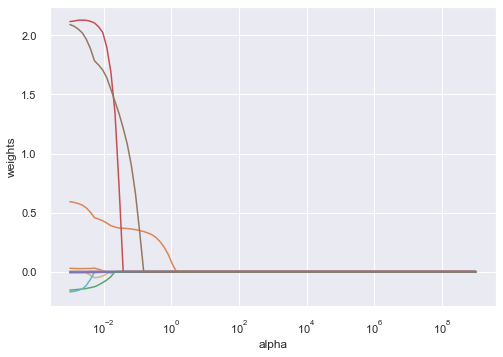

In [162]:
X4 = DatabaseDFII.copy().drop("12 month Cum Prod", axis = 1)
scaler = StandardScaler()
sX4 = scaler.fit_transform(X4)
#DataframeT = DataframeT.select_dtypes([np.number])
y4 = DatabaseDFII["12 month Cum Prod"]
sy4 = scaler.fit_transform(y4.values.reshape((-1,1)))
alphas = 10**np.linspace(10,-2, 100)*0.05
coefs = []
X4_train, X4_test, y4_train, y4_test = train_test_split(X4, y4, test_size = .4, random_state = 1)
Lasso = linear_model.Lasso(max_iter = 300000, tol = 0.0001, normalize = True)
for a in alphas:
    Lasso.set_params(alpha = a)
    Lasso.fit(X4_train, y4_train)
    coefs.append(Lasso.coef_)
ax = plt.gca()
ax.plot(alphas*2, coefs)
ax.set_xscale("log")
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
    
Lassocv = LassoCV(alphas = None, cv = 20, max_iter = 300000, normalize = True)
Lassocv.fit(X4_train, y4_train)

Lasso.set_params(alpha = Lassocv.alpha_)
Lasso.fit(X4_train, y4_train)

y4_pred = Lasso.predict(X4_test)
rmse = sqrt(metrics.mean_squared_error(y4_test, y4_pred))

print("Train score:", Lasso.score(X4_train, y4_train))
print("Test score:", Lasso.score(X4_test, y4_test))
print("Number of coefficients used:", np.sum(Lasso.coef_!=0))
print("Root mean squared error:", rmse)
print(Lasso.coef_)
pd.Series(Lasso.coef_, index = X4.columns)

#### Ridge Regression
Todo

Lateral Length    -0.000409
Stages             0.015434
Township          -0.956278
Range              0.151916
Section            0.016316
Total Prop, lbs    0.000002
Fluid, bbls        0.000060
Best1 Mo BOPD     -0.003333
Best3 Mo BOPD      0.028902
Best6 Mo BOPD     -0.233610
Best9 Mo BOPD      0.045417
Best12 Mo BOPD     0.579670
Latitude           9.304201
Longitude          3.436173
SPACING_CAPPED    -0.009672
Year Drilled       2.168779
dtype: float64
Train score: 0.9223308682022575
Test score: 0.9214827220713107
Root Mean squared error: 14.972232425184544
Mean Absolute Error: 9.908320835290061
Mean Squared Error: 224.16774379374746


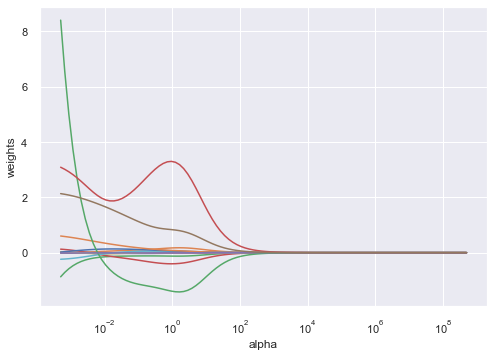

In [164]:
X5 = DatabaseDFII.copy().drop("12 month Cum Prod", axis = 1) 

y5 = DatabaseDFII["12 month Cum Prod"]
alphas = 10**np.linspace(10, -2, 100)*.05
coefs = []
ridge = Ridge(normalize = True)
for a in alphas:
    ridge.set_params(alpha = a)
    ridge.fit(X5, y5)
    coefs.append(ridge.coef_)
np.shape(coefs)
ax = plt.gca()
ax.plot(alphas, coefs)
ax.set_xscale('log')
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('weights')
X5_train, X5_test, y5_train, y5_test = train_test_split(X5, y5, test_size = 0.3, random_state = 1)
ridgecv = RidgeCV(alphas = alphas, scoring = 'neg_mean_squared_error', normalize = True)
ridgecv.fit(X5_train, y5_train)
ridgecv.alpha_
ridge = Ridge(alpha = ridgecv.alpha_, normalize = True)
ridge.fit(X5_train, y5_train)
y5_pred = ridge.predict(X5_test)
print(pd.Series(ridge.coef_, index = X5.columns))
print("Train score:", ridge.score(X5_train, y5_train))
print("Test score:", ridge.score(X5_test, y5_test))
print("Root Mean squared error:", sqrt(metrics.mean_squared_error(y5_test, y5_pred)))
print("Mean Absolute Error:", metrics.mean_absolute_error(y5_test, y5_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y5_test, y5_pred))


### Dimension Reduction/Clustering
Exploratory
Todo

## Correlations and Variable interactions


Original Dataset


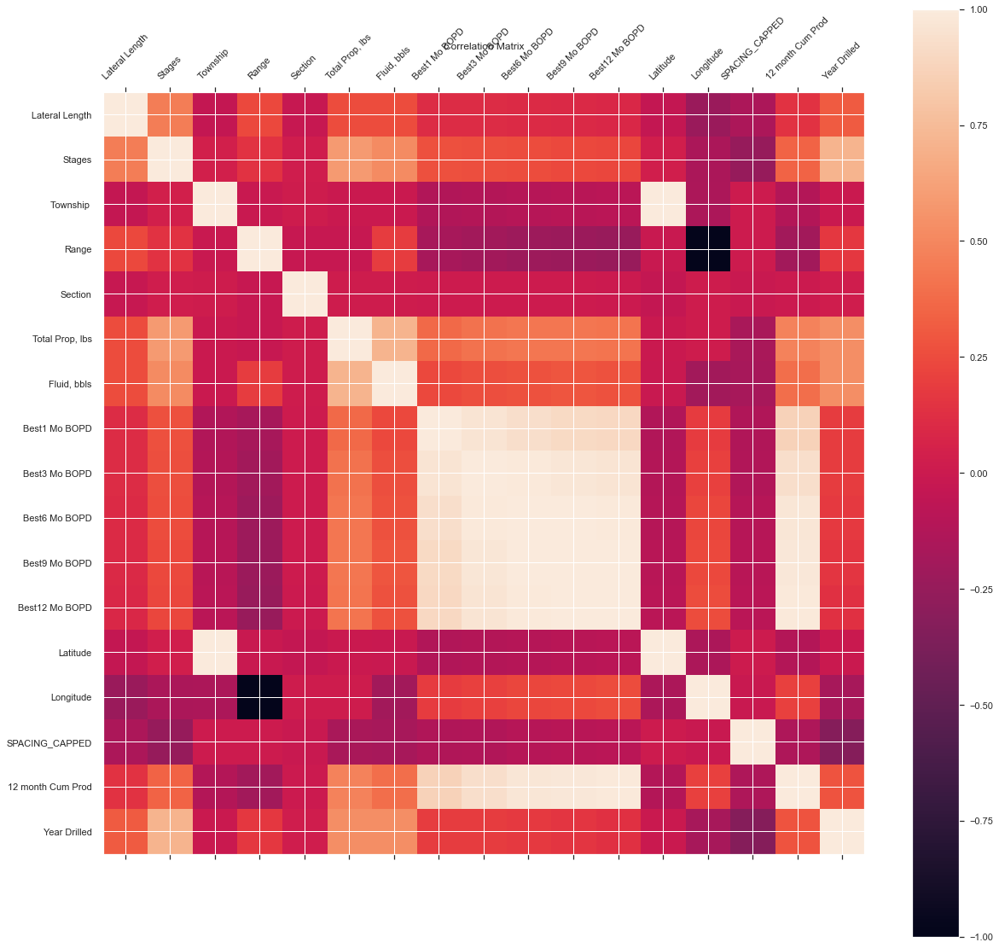

In [165]:
print("Original Dataset")
plot_corr(DataframeOriginal, 20)
plt.show()

Dataset with sklearn.Iterative Imputation: Multivariate Feature Imputation


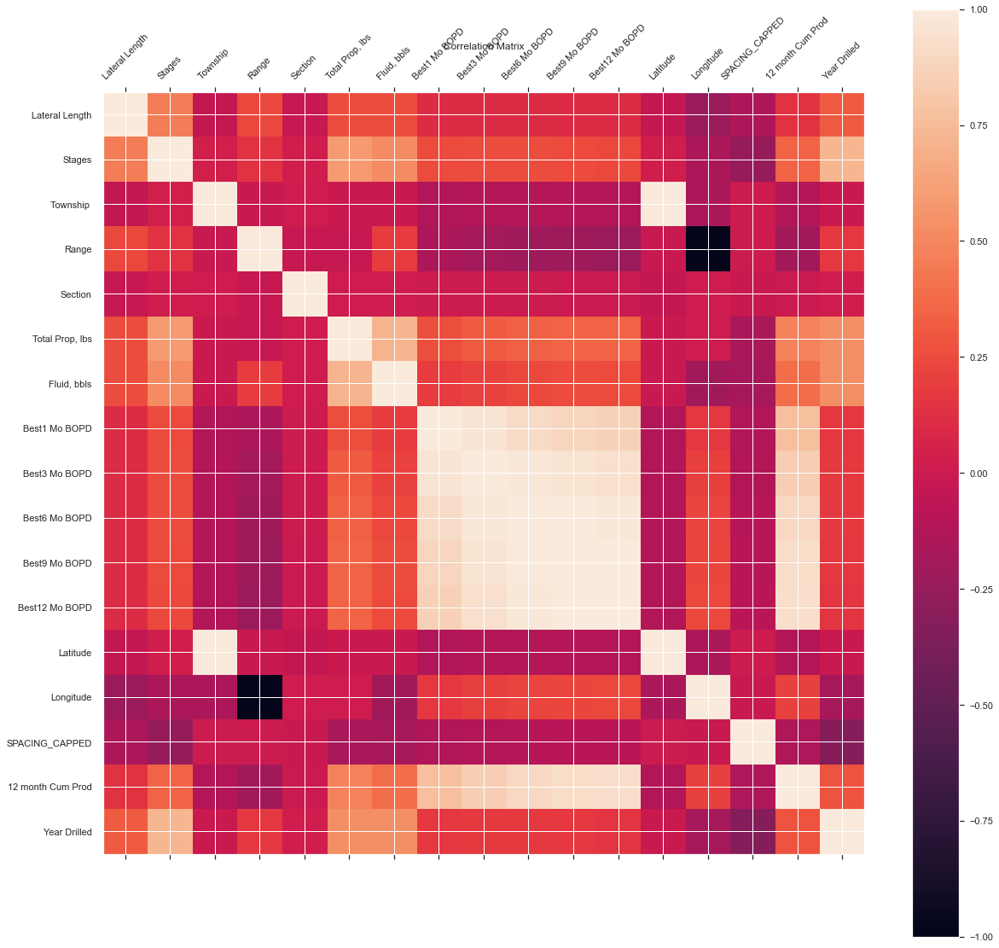

In [166]:
print("Dataset with sklearn.Iterative Imputation: Multivariate Feature Imputation")
plot_corr(DatabaseDFII, 20)
plt.show()

Original Dataset


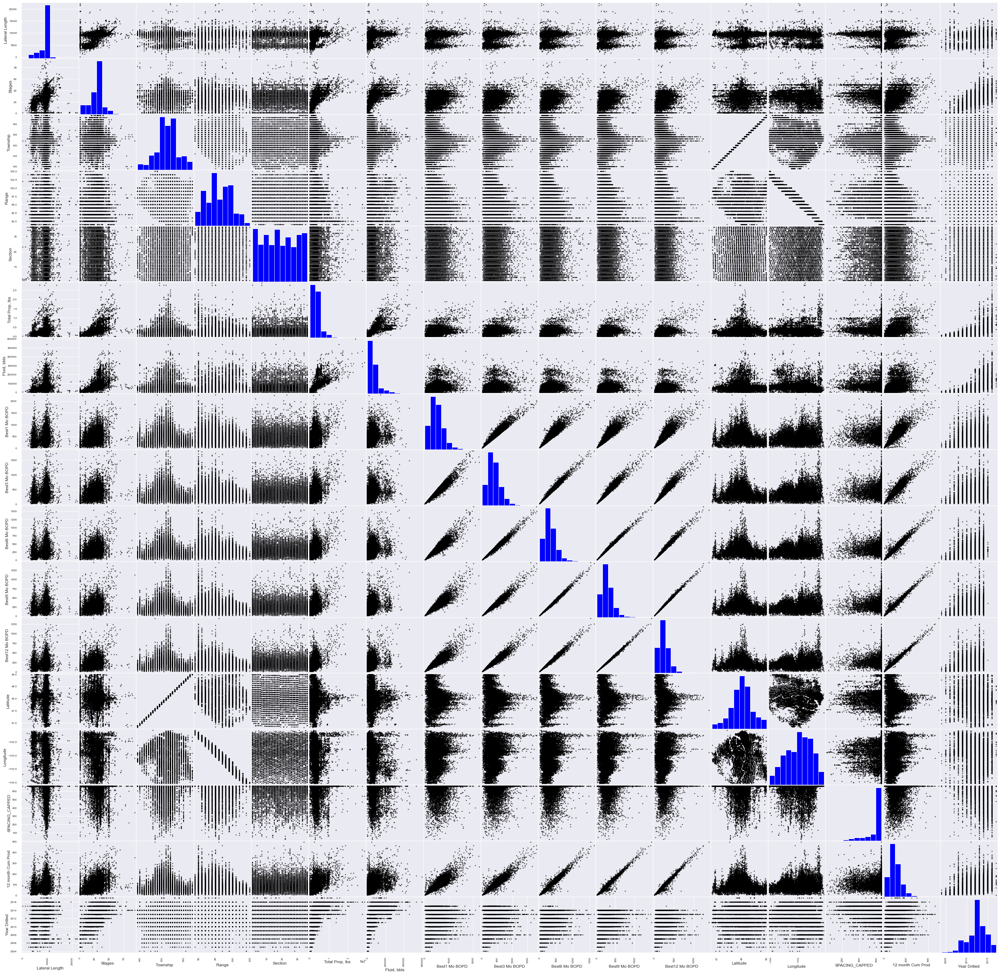

In [168]:
print("Original Dataset")
pd_plot.scatter_matrix(DataframeOriginal, alpha = 0.7,
                      figsize=(50,50), color='black',hist_kwds={'color':['blue']})
plt.show()

Dataset with sklearn.IterativeImputation: Multivariate Feature Imputation


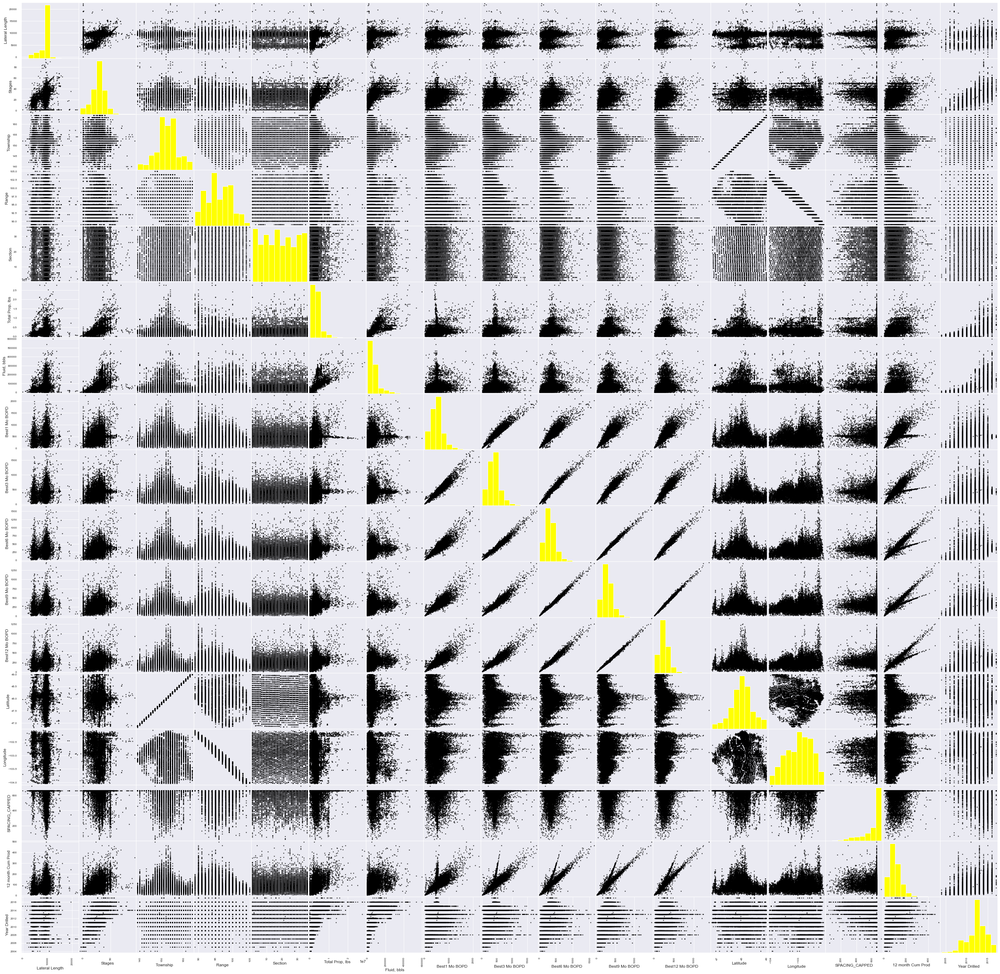

In [169]:
print("Dataset with sklearn.IterativeImputation: Multivariate Feature Imputation")
pd_plot.scatter_matrix(DatabaseDFII, alpha = 0.7,
          figsize=(50,50),color='black',hist_kwds={'color':['yellow']})
plt.show()

In [5]:
# MICE Todo

In [48]:
imputer = KNNImputer(n_neighbors=4)
DataframeT1 = DataframeT.copy().drop(["Sleeves", "P&P", "Frac Ports", \
                                      "Repeater Ports", "CT"], axis = 1)
DataframeKNN = imputer.fit_transform(DataframeT1)
DataframeKNN = pd.DataFrame(DataframeKNN)

In [ ]:
DataframeKNN.describe().transpose()


In [ ]:
pd_plot.scatter_matrix(DataframeKNN, alpha = 0.7,              # pandas matrix scatter plot
    figsize=(50, 50),color = 'black', hist_kwds={'color':['red']})
plt.show()


In [23]:
Category = "Completion Type"
DatabaseDFSleeves = pd.concat([\
                               DatabaseDF[DatabaseDF[Category] == \
                                          "Sleeves"], \
                               DatabaseDF[DatabaseDF[Category] == \
                                           "Sleeves and P & P"]])

DatabaseDFPandP = pd.concat([\
                            DatabaseDF[DatabaseDF[Category] == \
                                      "P & P"], \
                            DatabaseDF[DatabaseDF[Category] == \
                                      "Sleeves and P & P"], \
                            DatabaseDF[DatabaseDF[Category] == \
                                      "Frac Ports and P & P"], \
                            DatabaseDF[DatabaseDF[Category] == \
                                       "P & P and CT"], \
                            DatabaseDF[DatabaseDF[Category] == \
                                      "Repeater Ports and P & P"]])

DatabaseDFFracPorts = pd.concat([\
                                DatabaseDF[DatabaseDF[Category] == \
                                         "Frac Ports"], \
                                DatabaseDF[DatabaseDF[Category] == \
                                         "Frac Ports and P & P"], \
                                DatabaseDF[DatabaseDF[Category] == \
                                         "Frac Ports and Repeater Ports"]])

DatabaseDFRepeaterPorts = pd.concat([\
                                    DatabaseDF[DatabaseDF[Category] == \
                                        "Frac Ports and Repeater Ports"],
                                    DatabaseDF[DatabaseDF[Category] == \
                                              "Repeater Ports and P & P"]])

DatabaseDFCT = pd.concat([\
                         DatabaseDF[DatabaseDF[Category] == \
                                   "CT"], \
                         DatabaseDF[DatabaseDF[Category] == \
                                   "P & P and CT"]])
DatabaseDFOH = DatabaseDF[DatabaseDF[Category] == "OH"]

DatabaseDFScreen = DatabaseDF[DatabaseDF[Category] == "Screen"]

DatabaseDFCementedL = DatabaseDF[DatabaseDF[Category] == "Cemented Liner"]

DatabaseDFPerforatedL = DatabaseDF[DatabaseDF[Category] == \
                                   "Perforated Liner"]

Databaseother = pd.concat([DatabaseDFOH, DatabaseDFScreen, \
                           DatabaseDFCementedL, DatabaseDFPerforatedL])